In [1]:
#!python -m venv myenv
#!source myenv/bin/activate

In [2]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats
from sklearn.preprocessing import minmax_scale
import numpy as np

import warnings
warnings.filterwarnings("ignore")

In [84]:
#General Functions

def line_to_column_new(df,col1,col2):
    new_list = []
    
    for cols_c, val_sc in df.T.items():
        for row in range(309):
            new_list.append([val_sc['idMedicao'],val_sc['item'],row,
                            val_sc[str(row)+"_"+col1],
                            val_sc[str(row)+"_"+col2]])
    df_full = pd.DataFrame(new_list)
    df_full = df_full.rename(columns={0:'idMedicao', 1:'item',2:'sequencia',3:col1, 4:col2})
    return df_full

def line_to_column_new1(df,col1):
    new_list = []
    
    for cols_c, val_sc in df.T.items():
        for row in range(309):
            new_list.append([val_sc['idMedicao'],val_sc['item'],row,
                            val_sc[str(row)+"_"+col1]])
    df_full = pd.DataFrame(new_list)
    df_full = df_full.rename(columns={0:'idMedicao', 1:'item',2:'sequencia',3:col1})
    return df_full

def line_to_column_newcl(df,col1,len,offset):
    new_list = []
    i = 0
    for cols_c, val_sc in df.T.items():
        i=i+1
        for row in range(len):
            try:
                new_list.append([val_sc['idMedicao'],val_sc['item'],row+offset,
                            val_sc[str(row+offset)+"_"+col1],val_sc['Cluster']])
            except KeyError:
                new_list.append([i,val_sc['item'],row+offset,val_sc[str(row+offset)+"_"+col1],
                            val_sc['Cluster']])                
    df_full = pd.DataFrame(new_list)
    df_full = df_full.rename(columns={0:'idMedicao', 1:'item',2:'sequencia',3:col1,4:'Cluster'})
    return df_full

def line_to_column_vc(df,name,col1,col2):
    new_list = []
    
    for cols_c, val_sc in df.T.items():
        for row in range(61):
            new_list.append([name,50*row,
                            val_sc[col1+"_"+str(50*row)],
                            val_sc[col2+"_"+str(50*row)]])
    df_full = pd.DataFrame(new_list)
    df_full = df_full.rename(columns={0:'item',1:'sequencia',2:col1, 3:col2})
    return df_full

def line_to_column(df,name,col1):
    new_list = []
    
    for cols_c, val_sc in df.T.items():
        for row in range(61):
            new_list.append([name,50*row,
                            val_sc[str(50*row)+"_"+col1],
                            val_sc['Cluster']])
    df_full = pd.DataFrame(new_list)
    df_full = df_full.rename(columns={0:'item',1:'sequencia',2:col1,3:'Cluster'})
    return df_full

def line_to_column_teste(df,name,col1):
    new_list = []
    
    for cols_c, val_sc in df.T.items():
        for row in range(61):
            new_list.append([name,50*row,
                            val_sc[str(50*row)+"_"+col1]])
    df_full = pd.DataFrame(new_list)
    df_full = df_full.rename(columns={0:'item',1:'sequencia',2:col1})
    return df_full

### CARREGAR DADOS

In [4]:
# prompt: Read sheet Consolidado from this spreadsheet: /content/drive/Shareddrives/Moura_TAD/Moura x UPE Compartilhamento/Estudo Engenharia de Processos/GM60AD - Tensões Elemento invertido.xlsm

#df = pd.read_excel('GM60AD - Tensões Elemento invertido.xlsm', sheet_name='Consolidado')
#df = pd.read_csv("C:/Users/carlo/OneDrive/Github/DS-Moura/data/02_UN10_LIA02_TAD02_measurement_202408271022_ts_w_sampletime_format.csv")
#df1 = pd.read_csv("C:/Users/carlo/OneDrive/Github/DS-Moura/data/TAD_INSPECAO_measurement_202410071521.csv")
#df2 = pd.read_csv("C:/Users/carlo/OneDrive/Github/DS-Moura/data/TAD_INSPECAO_measurement_202410071521_2.csv")
df = pd.read_csv("./data/new_machine_data.csv")

df = df.drop(columns='Unnamed: 0')
df.head(1)

,DataHora,valorMed,maquina,parametro,item,idMedicao,0_corrente,1_corrente,2_corrente,3_corrente,...,300_tensao,301_tensao,302_tensao,303_tensao,304_tensao,305_tensao,306_tensao,307_tensao,308_tensao,309_tensao
0,2024-10-04 11:19:24.928,1.0,0001.ACAB.INSPECAO.TAD,TAD.R.TESTE.CAB01,FI60EFBMGE,1.0,-0.066148,-0.066148,0.0,95.252914,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


### Começa a partir daqui

In [5]:
#df_corrente = pd.read_csv('../data/df_corrente_nd.csv')
#df_tensao = pd.read_csv('../data/df_tensao_nd.csv')

df_full = pd.read_csv('./data/new_machine_data.csv')

In [6]:
#df_corrente = df_corrente.drop(columns=['Unnamed: 0'])
#df_tensao = df_tensao.drop(columns=['Unnamed: 0'])
df_full = df_full.drop(columns=['Unnamed: 0'])

In [7]:
df_full.head(1)

,DataHora,valorMed,maquina,parametro,item,idMedicao,0_corrente,1_corrente,2_corrente,3_corrente,...,300_tensao,301_tensao,302_tensao,303_tensao,304_tensao,305_tensao,306_tensao,307_tensao,308_tensao,309_tensao
0,2024-10-04 11:19:24.928,1.0,0001.ACAB.INSPECAO.TAD,TAD.R.TESTE.CAB01,FI60EFBMGE,1.0,-0.066148,-0.066148,0.0,95.252914,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [8]:
df_corrente = df_full.iloc[:,0:316].copy()
df_tensao = df_full.iloc[:, list(range(5)) + list(range(317, 626))].copy()

# ANÁLISE DADOS DA NOVA MÁQUINA

In [9]:
x = line_to_column_new( df_full,'tensao','corrente')

In [10]:
x['resistencia'] = x['tensao']/x['corrente']
x['condutancia'] = 1/x['resistencia']

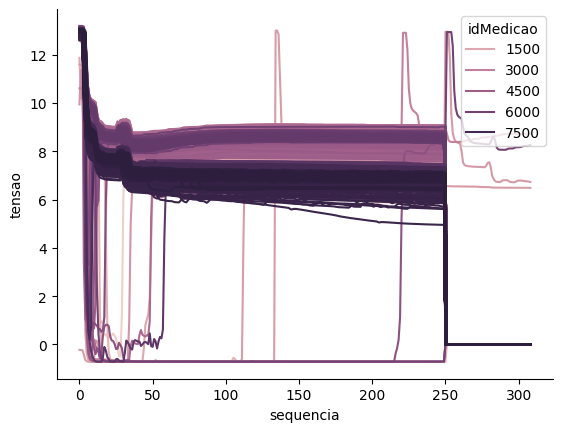

In [11]:
sns.lineplot(x, x='sequencia', y='tensao',hue='idMedicao')
plt.gca().spines[['top', 'right',]].set_visible(False)

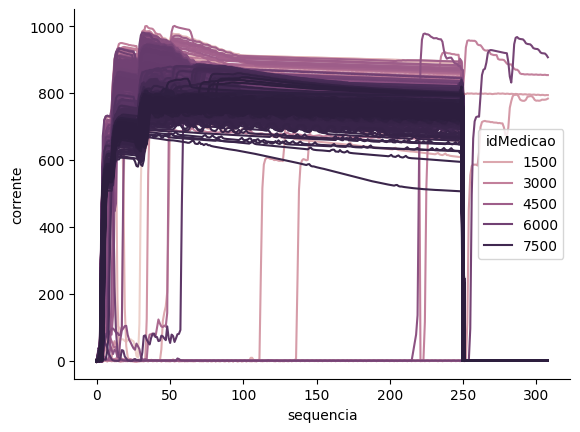

In [12]:
sns.lineplot(x, x='sequencia', y='corrente',hue='idMedicao')
plt.gca().spines[['top', 'right',]].set_visible(False)

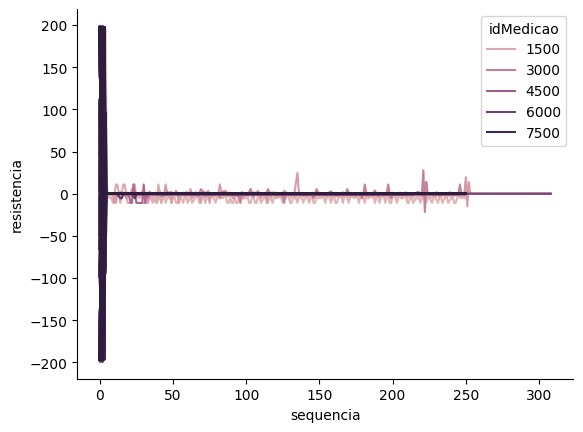

In [13]:
sns.lineplot(x, x='sequencia', y='resistencia',hue='idMedicao')
plt.gca().spines[['top', 'right',]].set_visible(False)

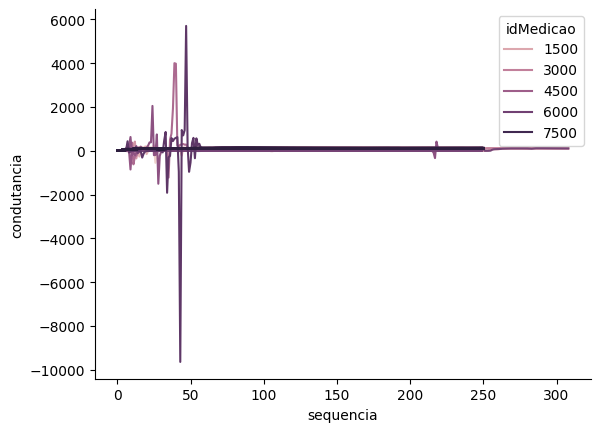

In [14]:
sns.lineplot(x, x='sequencia', y='condutancia',hue='idMedicao')
plt.gca().spines[['top', 'right',]].set_visible(False)

In [15]:
#drop initial outliers in voltage
drop_list = []
for i in range(309):
    drop_list.append(df_full [ df_full[str(i)+'_tensao'] < 0 ].index)

new_list = []
for i in drop_list:
    for y in i:
        new_list.append(y)

drop_index = set(new_list)

df_full = df_full.drop(drop_index)

In [16]:
#drop initial outliers in current
drop_list = []
for i in range(309):
    drop_list.append(df_full [ df_full[str(i)+'_corrente'] < 0].index)

new_list = []
for i in drop_list:
    for y in i:
        new_list.append(y)

drop_index = set(new_list)

df_full = df_full.drop(drop_index)
x = line_to_column_new( df_full,'tensao','corrente')

In [17]:
num = df_full._get_numeric_data()
num[num <= 0] = 0.1
x = line_to_column_new( df_full,'tensao','corrente')

In [18]:
x['resistencia'] = x['tensao']/x['corrente']
x['condutancia'] = 1/x['resistencia']

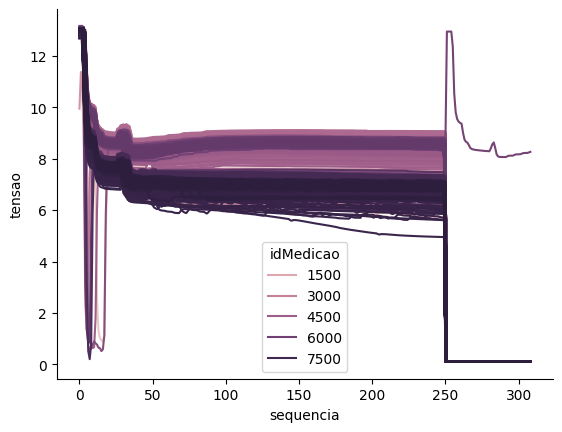

In [19]:
sns.lineplot(x, x='sequencia', y='tensao',hue='idMedicao')
plt.gca().spines[['top', 'right',]].set_visible(False)

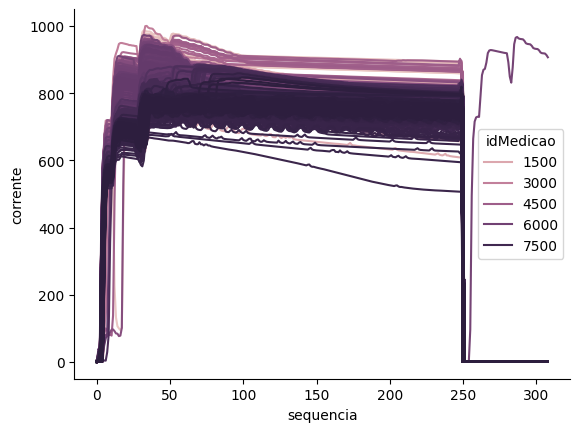

In [20]:
sns.lineplot(x, x='sequencia', y='corrente',hue='idMedicao')
plt.gca().spines[['top', 'right',]].set_visible(False)

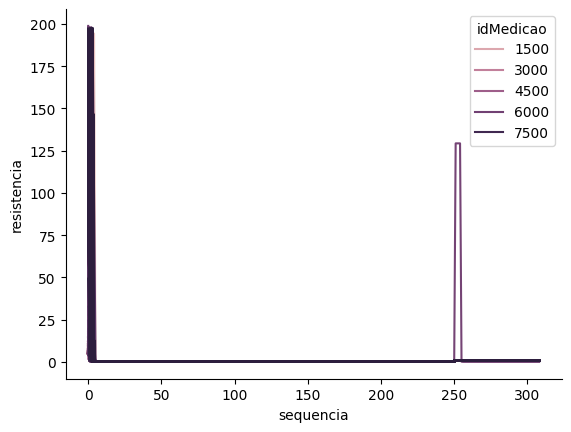

In [21]:
sns.lineplot(x, x='sequencia', y='resistencia',hue='idMedicao')
plt.gca().spines[['top', 'right',]].set_visible(False)

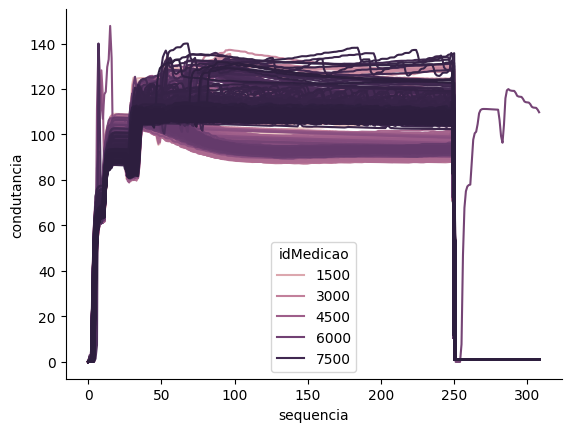

In [22]:
sns.lineplot(x, x='sequencia', y='condutancia',hue='idMedicao')
plt.gca().spines[['top', 'right',]].set_visible(False)

In [23]:
#df_new = df[['dataHora','item']][ df['item'] == 'M100HE' ].copy()

max_v = x['tensao'].max()
min_v = x['tensao'].min()
max_c = x['corrente'].max()
min_c = x['corrente'].min()

max_res = x['resistencia'].max()
min_res = x['resistencia'].min()
max_cond = x['condutancia'].max()
min_cond = x['condutancia'].min()

In [24]:
print(max_v)
print(min_v)
print(max_c)
print(min_c)
print(max_res)
print(min_res)
print(max_cond)
print(min_cond)


13.155085563659668
0.1
1000.3540649414062
0.066147856414318
198.86527190431886
0.006768690277956857
147.73906899782864
0.005028530071762029


In [25]:
df_new = df_full.copy()
for i in range(310):    
    df_new[str(i)+'_resistencia'] = df_new[str(i)+'_tensao']/df_new[str(i)+'_corrente']
for i in range(310):
    df_new[str(i)+'_condutancia'] = df_new[str(i)+'_corrente']/df_new[str(i)+'_tensao']
for i in range(310):
    df_new[str(i)+'_NormRes'] = ((df_new[str(i)+'_resistencia']-min_res)/(max_res-min_res))
for i in range(310):
    df_new[str(i)+'_NormCond'] = ((df_new[str(i)+'_condutancia']-min_cond)/(max_cond-min_cond))


In [26]:
input_resist = df_new.iloc[:,np.r_[0:6,626:936]].copy()
input_cond = df_new.iloc[:,np.r_[0:6,936:1246]].copy()
input_resist_n = df_new.iloc[:,np.r_[0:6,1246:1556]].copy()
input_cond_n = df_new.iloc[:,np.r_[0:6,1556:1866]].copy()

In [46]:
input1['item'].unique()

array(['FI60EFBMGE', 'FI72EFBMGE', 'GM70LDMGE', 'GM50EDMGE', 'VW95QDMFA',
       'GM60ADMGE', 'FO75CDMFA', 'FCA50EDMGE'], dtype=object)

In [49]:
input1.groupby('item')['item'].count()

item
FCA50EDMGE    671
FI60EFBMGE    900
FI72EFBMGE    567
FO75CDMFA     683
GM50EDMGE     319
GM60ADMGE     838
GM70LDMGE     303
VW95QDMFA     360
Name: item, dtype: int64

,Description,Value
0,Session id,123
1,Original data shape,"(900, 186)"
2,Transformed data shape,"(900, 181)"
3,Ignore features,5
4,Numeric features,180
5,Categorical features,1
6,Preprocess,True
7,Imputation type,simple
8,Numeric imputation,mean
9,Categorical imputation,mode


,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,0.9067,3613.0008,0.1766,0,0,0


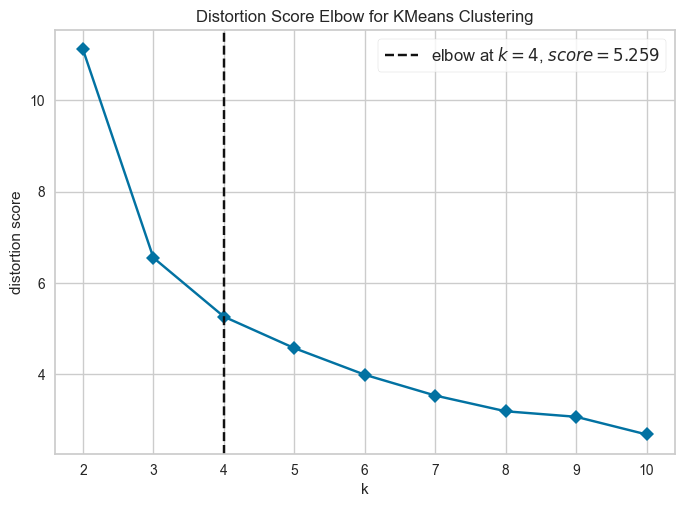

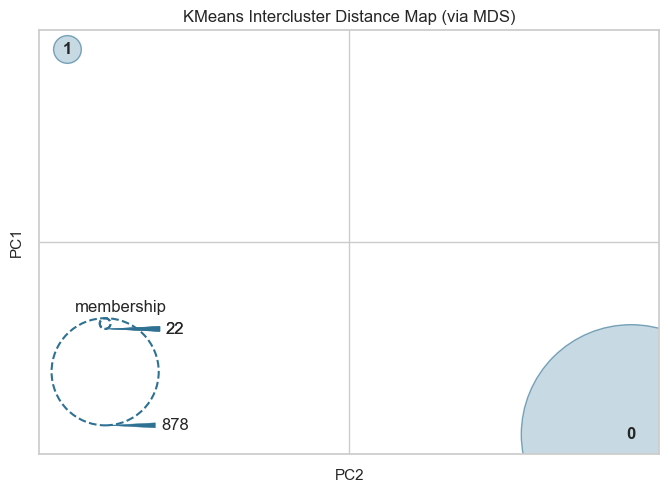

In [111]:
input1 = input_cond_n.iloc[ :, np.r_[0:6,66:246]].copy()
ignore_features = ['DataHora','valorMed','maquina','parametro','idMedicao']

from pycaret.clustering import *
clustering1 = setup(input1 [ input1['item'] == 'FI60EFBMGE'],ignore_features = ignore_features, session_id = 123)#, feature_selection = True)

kmeans1 = create_model('kmeans',num_clusters = 2)

results1 = assign_model(kmeans1)

plot_model(kmeans1)

plot_model(kmeans1, plot = 'distribution')

plot_model(kmeans1, plot = 'elbow')

plot_model(kmeans1, plot = 'distance')

,Description,Value
0,Session id,123
1,Original data shape,"(900, 186)"
2,Transformed data shape,"(900, 181)"
3,Ignore features,5
4,Numeric features,180
5,Categorical features,1
6,Preprocess,True
7,Imputation type,simple
8,Numeric imputation,mean
9,Categorical imputation,mode


,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,0.9067,3613.0008,0.1766,0,0,0


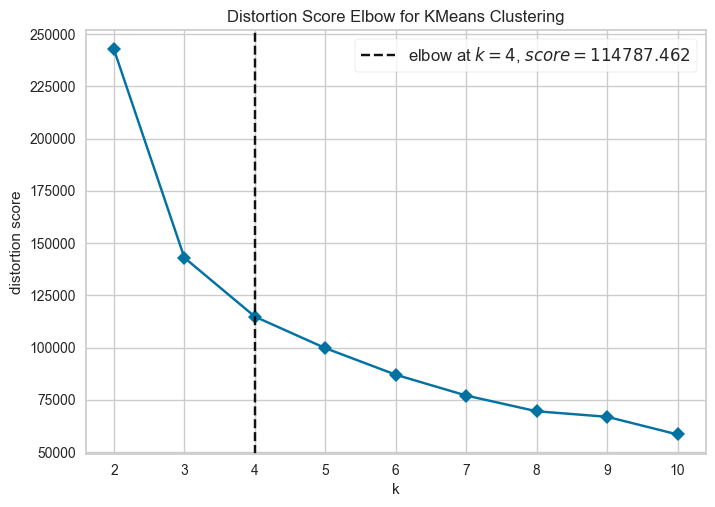

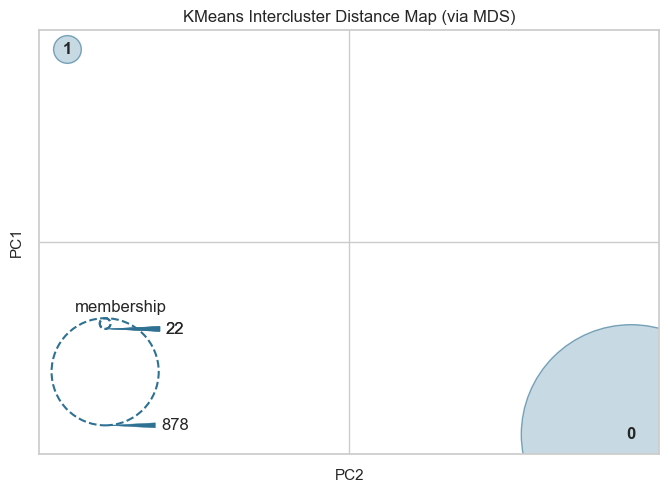

In [104]:
input4 = input_cond.iloc[ :, np.r_[0:6,66:246]].copy()
ignore_features = ['DataHora','valorMed','maquina','parametro','idMedicao']

from pycaret.clustering import *
clustering4 = setup(input4[ input4['item'] == 'FI60EFBMGE' ],ignore_features = ignore_features, session_id = 123)#, feature_selection = True)

kmeans4 = create_model('kmeans',num_clusters = 2)

results4 = assign_model(kmeans4)

plot_model(kmeans4)

plot_model(kmeans4, plot = 'distribution')

plot_model(kmeans4, plot = 'elbow')

plot_model(kmeans4, plot = 'distance')

,Description,Value
0,Session id,123
1,Original data shape,"(900, 316)"
2,Transformed data shape,"(900, 311)"
3,Ignore features,5
4,Numeric features,310
5,Categorical features,1
6,Preprocess,True
7,Imputation type,simple
8,Numeric imputation,mean
9,Categorical imputation,mode


,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,0.5179,1062.2120,0.7496,0,0,0


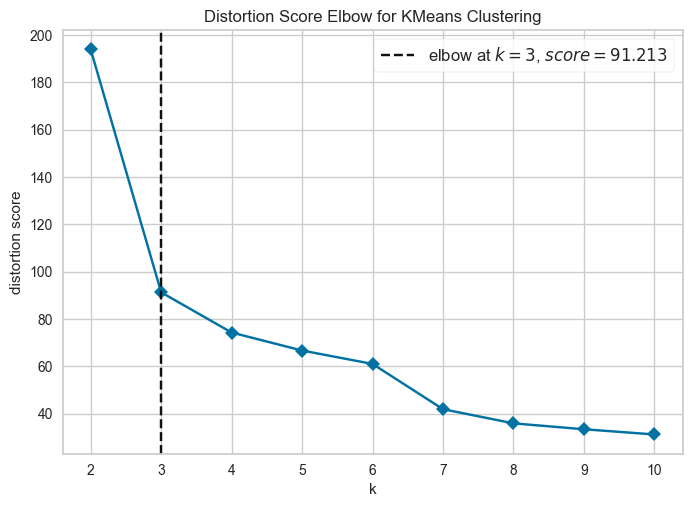

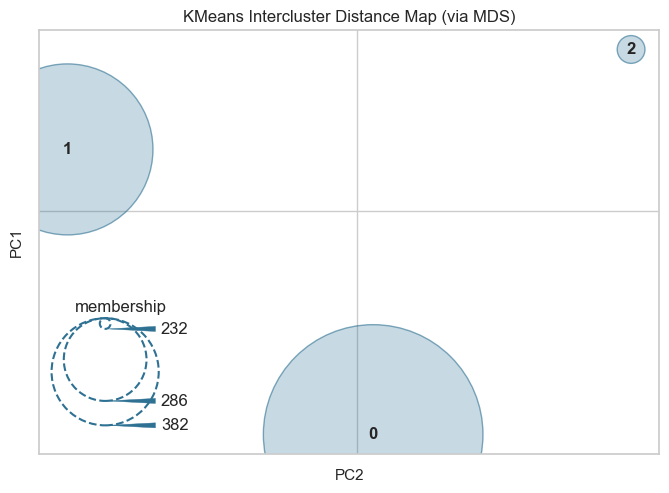

In [55]:
input2 = input_resist_n.copy()
ignore_features = ['DataHora','valorMed','maquina','parametro','idMedicao']

from pycaret.clustering import *
clustering2 = setup(input2[ input2['item'] == 'FI60EFBMGE'],ignore_features = ignore_features, session_id = 123)#, feature_selection = True)

kmeans2 = create_model('kmeans',num_clusters = 3)

results2 = assign_model(kmeans2)

plot_model(kmeans2)

plot_model(kmeans2, plot = 'distribution')

plot_model(kmeans2, plot = 'elbow')

plot_model(kmeans2, plot = 'distance')

,Description,Value
0,Session id,123
1,Original data shape,"(900, 316)"
2,Transformed data shape,"(900, 311)"
3,Ignore features,5
4,Numeric features,310
5,Categorical features,1
6,Preprocess,True
7,Imputation type,simple
8,Numeric imputation,mean
9,Categorical imputation,mode


,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,0.5179,1062.2120,0.7496,0,0,0


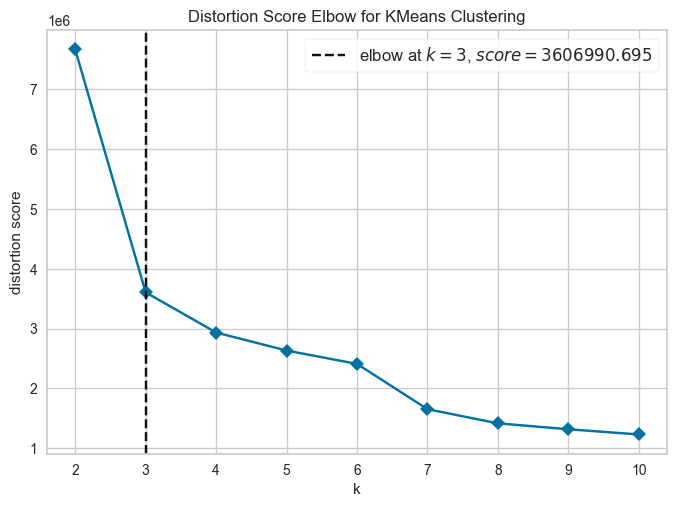

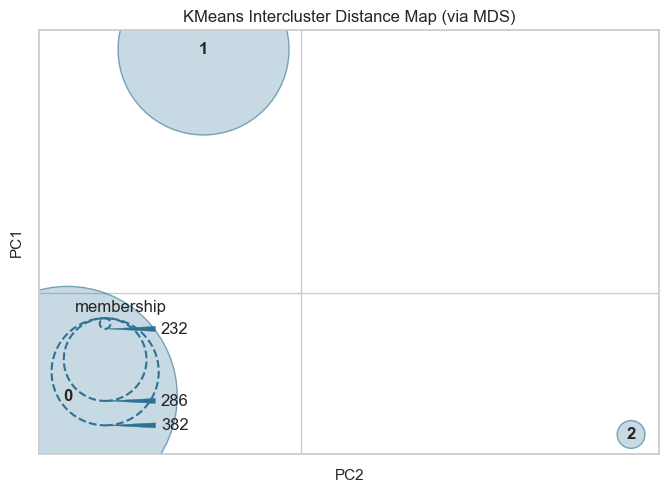

In [56]:
input3 = input_resist.copy()
ignore_features = ['DataHora','valorMed','maquina','parametro','idMedicao']

from pycaret.clustering import *
clustering3 = setup(input3[ input3['item'] == 'FI60EFBMGE'],ignore_features = ignore_features, session_id = 123)#, feature_selection = True)

kmeans3 = create_model('kmeans',num_clusters = 3)

results3 = assign_model(kmeans3)

plot_model(kmeans3)

plot_model(kmeans3, plot = 'distribution')

plot_model(kmeans3, plot = 'elbow')

plot_model(kmeans3, plot = 'distance')

In [106]:
##Resultado condutancia

clust_cond_n = line_to_column_newcl(results1,'NormCond',results1.shape[1]-2,60)
clust_cond = line_to_column_newcl(results4,'condutancia',results4.shape[1]-2,60)

In [33]:
palette={'Cluster 0':'C0','Cluster 1':'C1','Cluster 2':'C2','Cluster 3':'C3'}

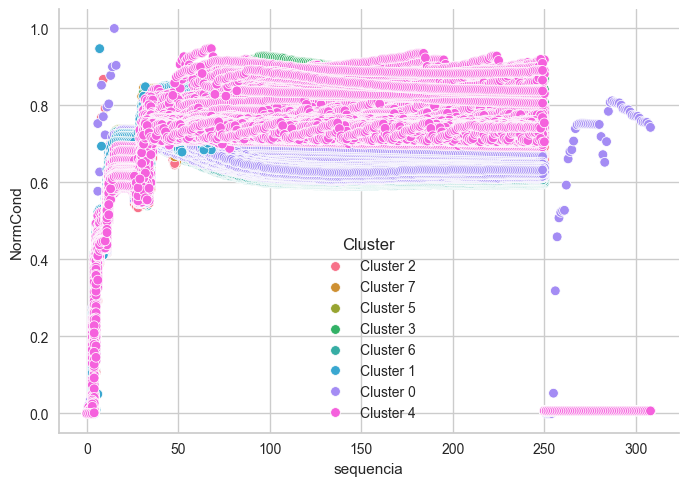

In [34]:
sns.scatterplot(clust_cond_n, x='sequencia', y='NormCond', hue='Cluster')
plt.gca().spines[['top', 'right',]].set_visible(False)

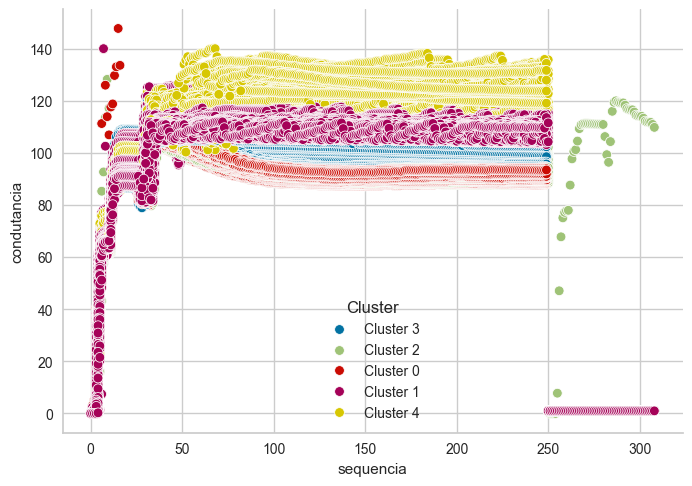

In [35]:
sns.scatterplot(clust_cond, x='sequencia', y='condutancia', hue='Cluster')
plt.gca().spines[['top', 'right',]].set_visible(False)

In [36]:
#Resultado resistência

clust_resist_n = line_to_column_newcl(results2,'NormRes')
clust_resist = line_to_column_newcl(results3,'resistencia')

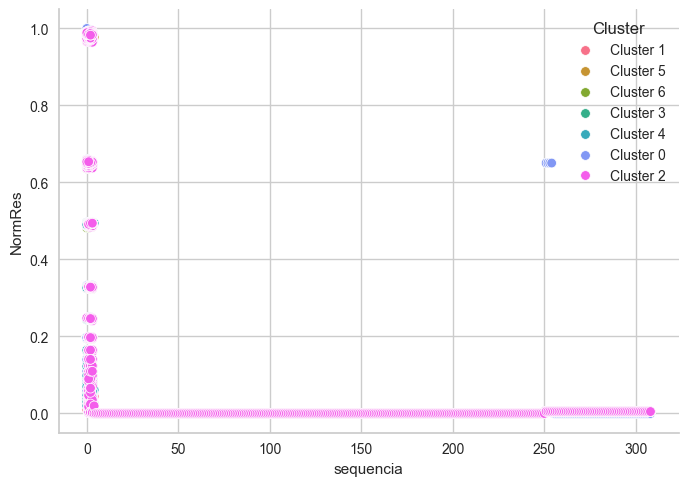

In [37]:
sns.scatterplot(clust_resist_n, x='sequencia', y='NormRes', hue='Cluster')
plt.gca().spines[['top', 'right',]].set_visible(False)

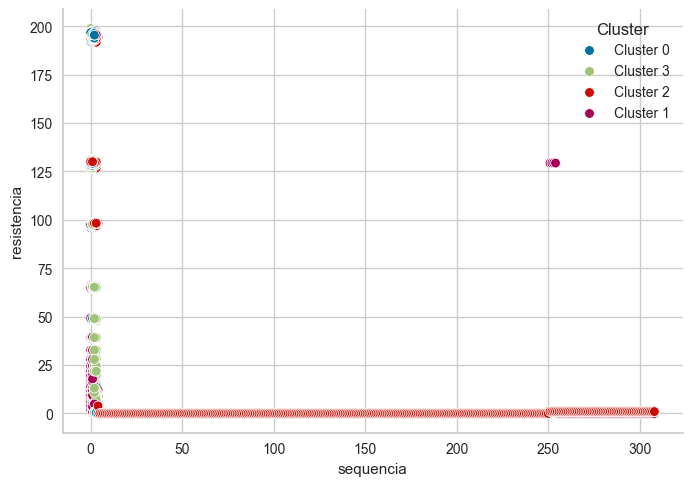

In [38]:
sns.scatterplot(clust_resist, x='sequencia', y='resistencia', hue='Cluster')
plt.gca().spines[['top', 'right',]].set_visible(False)

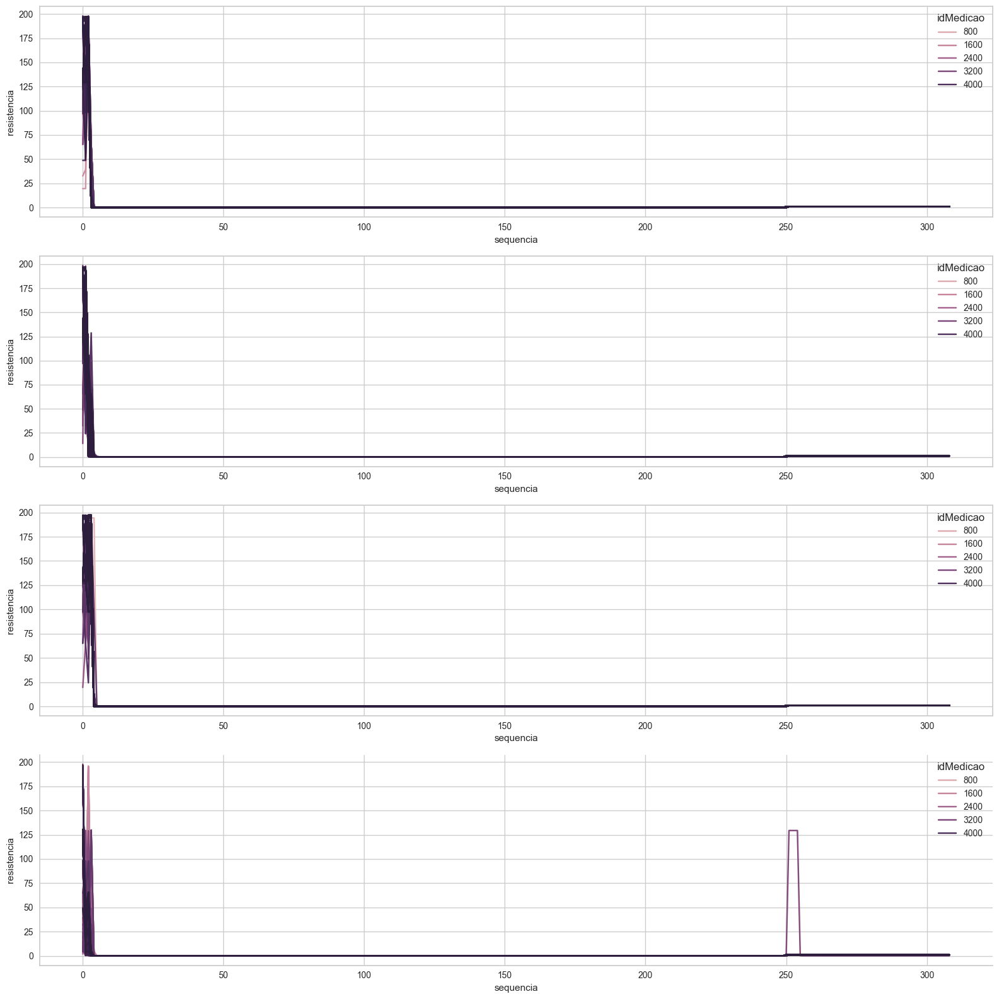

In [39]:
total = len(clust_resist['Cluster'].unique())
fig, ax = plt.subplots(total,1,figsize=(16,16))

for x,y in zip(clust_resist['Cluster'].unique(),range(len(clust_resist['Cluster'].unique()))):
    sns.lineplot(clust_resist[ clust_resist['Cluster'] == x ], x='sequencia', y='resistencia',hue='idMedicao',ax=ax[y])
    
plt.gca().spines[['top', 'right',]].set_visible(False)
plt.tight_layout()
plt.show()

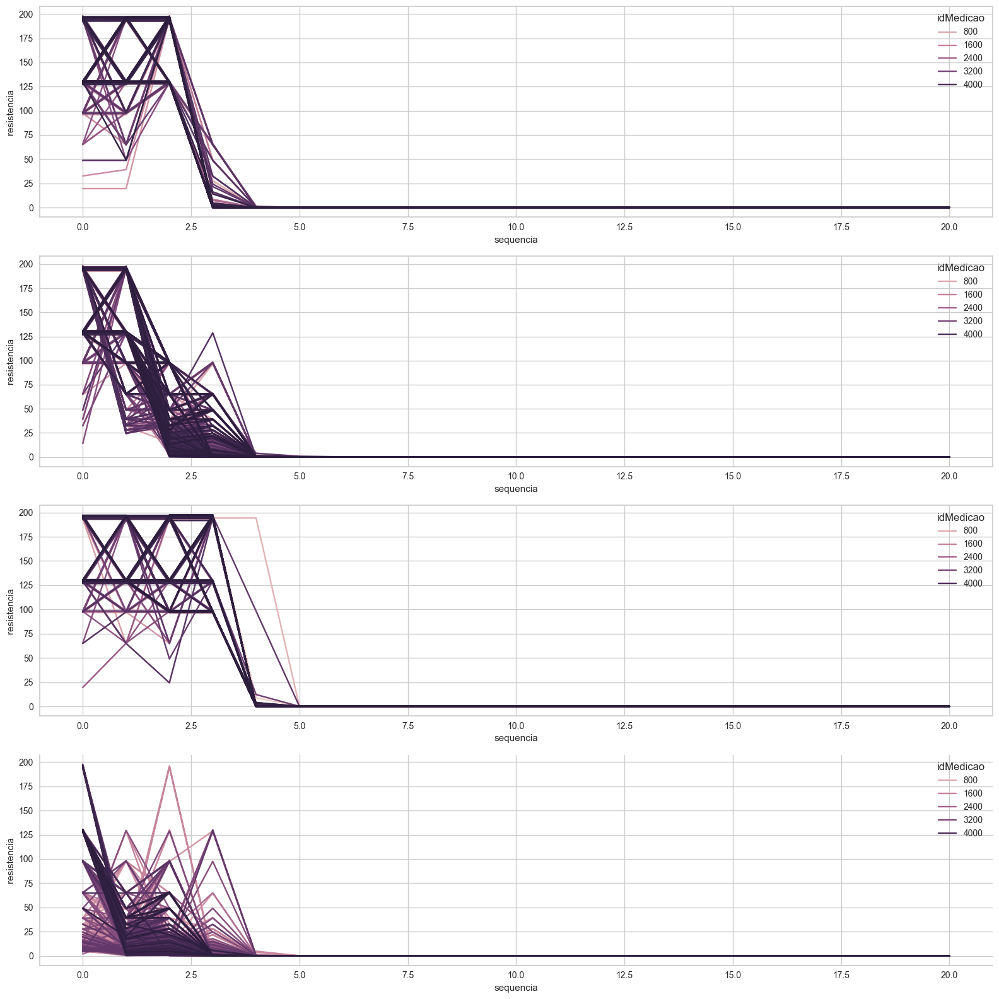

In [40]:


total = len(clust_resist['Cluster'].unique())
fig, ax = plt.subplots(total,1,figsize=(16,16))

for x,y in zip(clust_resist['Cluster'].unique(),range(len(clust_resist['Cluster'].unique()))):
    sns.lineplot(clust_resist[ (clust_resist['Cluster'] == x) & (clust_resist['sequencia'].between(0,20)) ], x='sequencia', y='resistencia',hue='idMedicao',ax=ax[y])
    
plt.gca().spines[['top', 'right',]].set_visible(False)
plt.tight_layout()
plt.show()

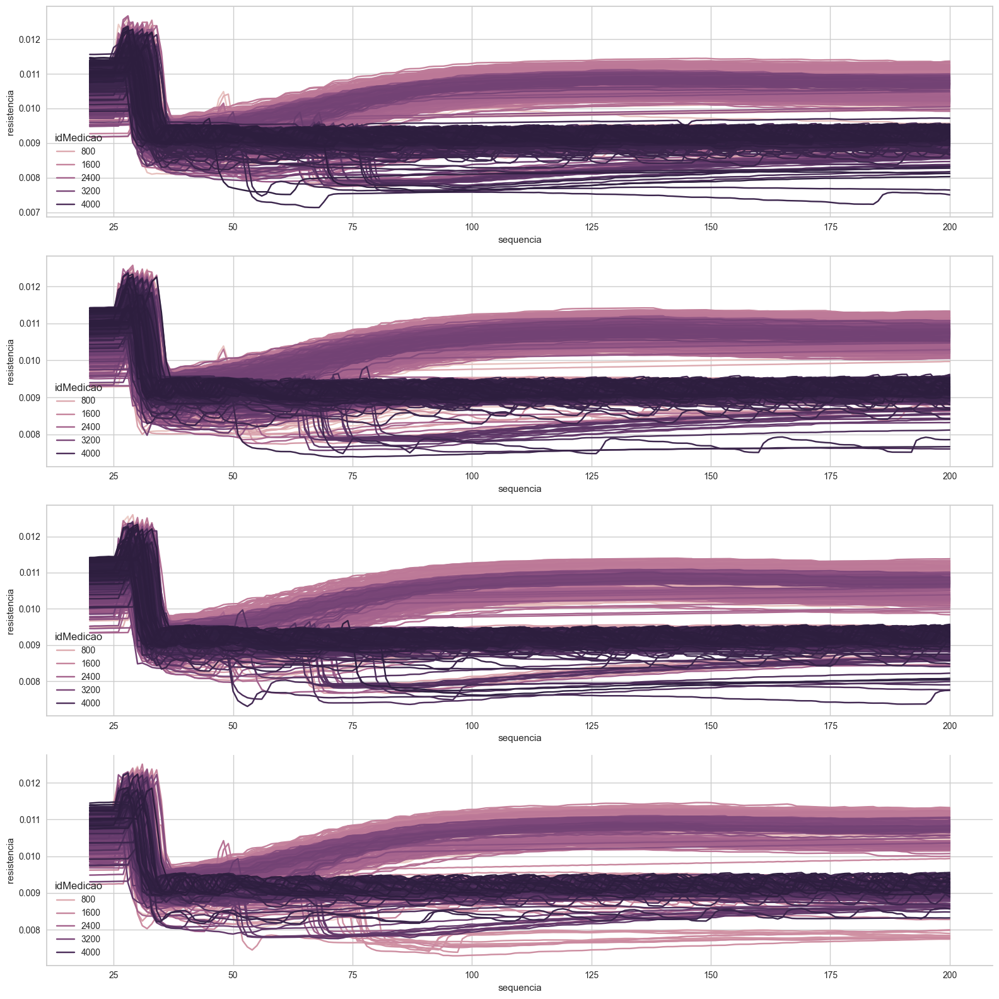

In [41]:


total = len(clust_resist['Cluster'].unique())
fig, ax = plt.subplots(total,1,figsize=(16,16))

for x,y in zip(clust_resist['Cluster'].unique(),range(len(clust_resist['Cluster'].unique()))):
    sns.lineplot(clust_resist[ (clust_resist['Cluster'] == x) & (clust_resist['sequencia'].between(20,200) ], x='sequencia', y='resistencia',hue='idMedicao',ax=ax[y])
    
plt.gca().spines[['top', 'right',]].set_visible(False)
plt.tight_layout()
plt.show()

### Análise dos clusters da condutância

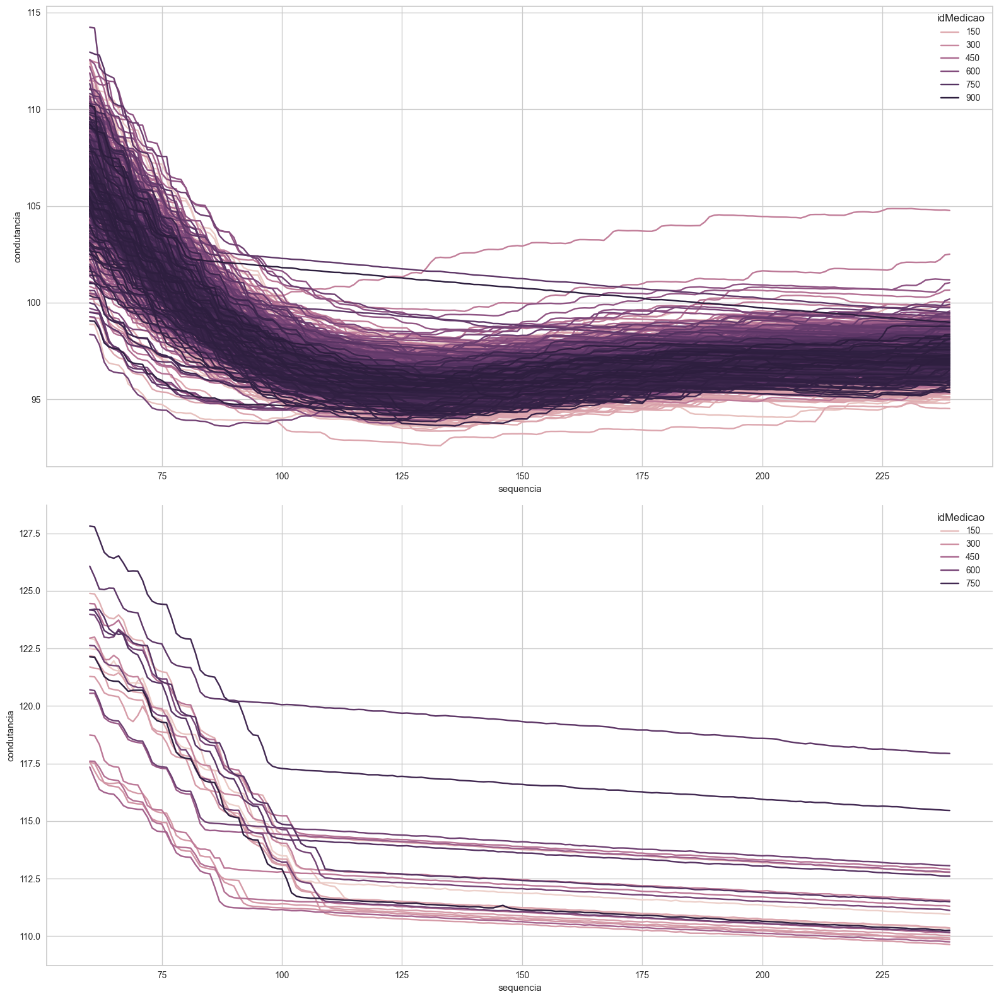

In [107]:
total = len(clust_cond['Cluster'].unique())
fig, ax = plt.subplots(total,1,figsize=(16,16))

for x,y in zip(clust_cond['Cluster'].unique(),range(len(clust_cond['Cluster'].unique()))):
    sns.lineplot(clust_cond[ clust_cond['Cluster'] == x] , x='sequencia', y='condutancia',hue='idMedicao',ax=ax[y])
    
plt.gca().spines[['top', 'right',]].set_visible(False)
plt.tight_layout()
plt.show()

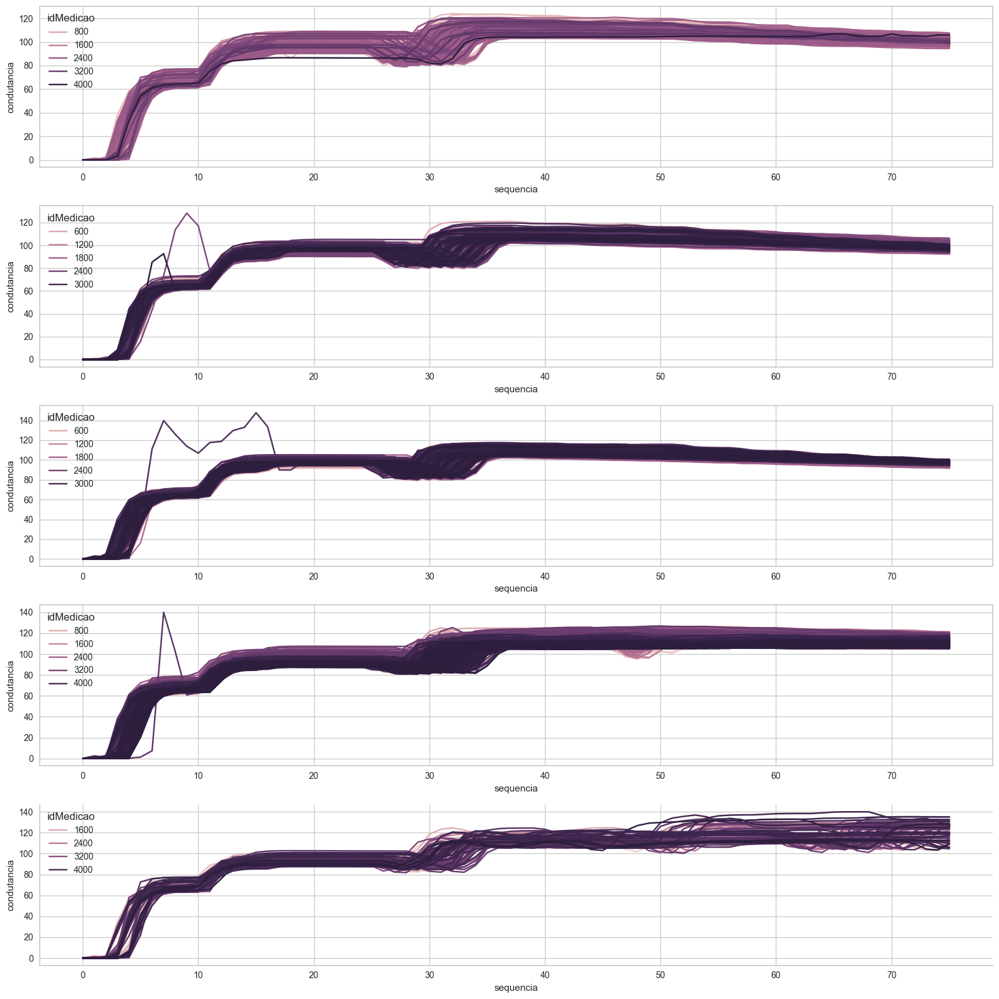

In [43]:
total = len(clust_cond['Cluster'].unique())
fig, ax = plt.subplots(total,1,figsize=(16,16))

for x,y in zip(clust_cond['Cluster'].unique(),range(len(clust_cond['Cluster'].unique()))):
    sns.lineplot(clust_cond[ (clust_cond['Cluster'] == x) & (clust_resist['sequencia'].between(0,75)) ], x='sequencia', y='condutancia',hue='idMedicao',ax=ax[y])
    
plt.gca().spines[['top', 'right',]].set_visible(False)
plt.tight_layout()
plt.show()

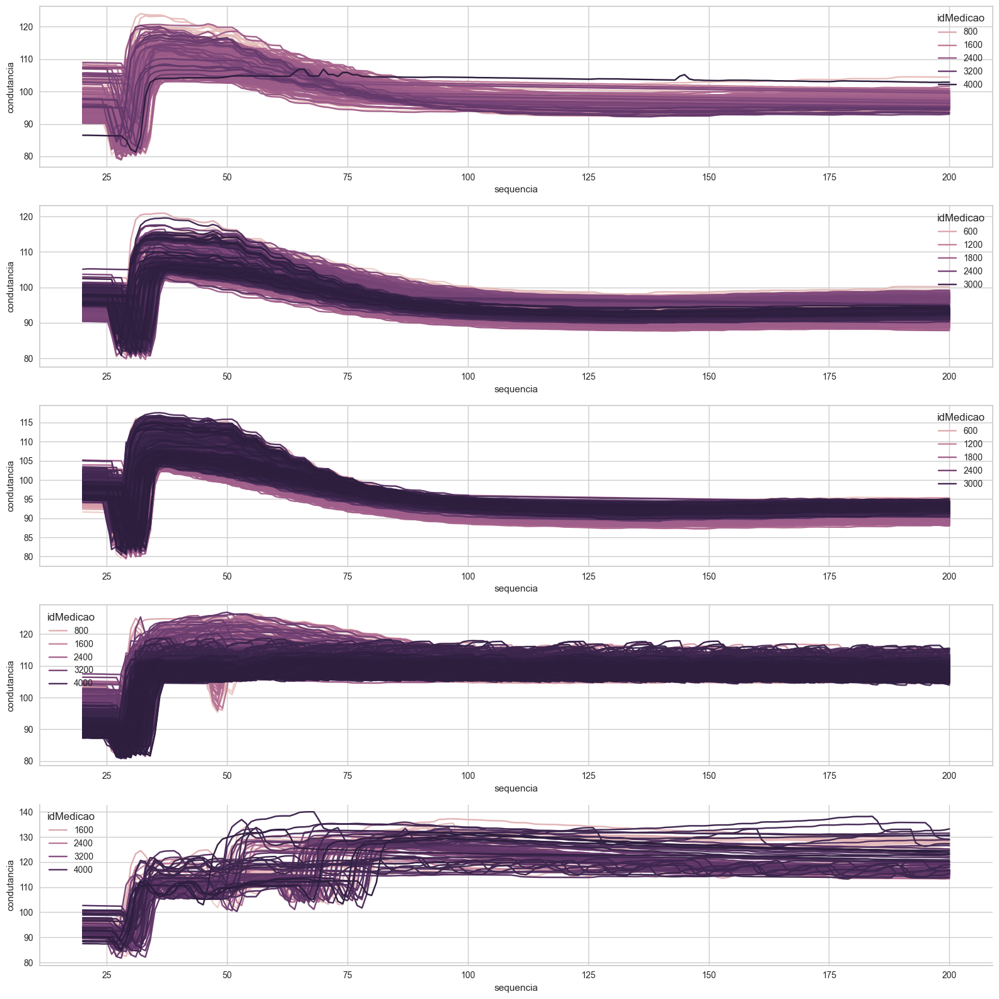

In [44]:
total = len(clust_cond['Cluster'].unique())
fig, ax = plt.subplots(total,1,figsize=(16,16))

for x,y in zip(clust_cond['Cluster'].unique(),range(len(clust_cond['Cluster'].unique()))):
    sns.lineplot(clust_cond[ (clust_cond['Cluster'] == x) & (clust_resist['sequencia'].between(20,200)) ], x='sequencia', y='condutancia',hue='idMedicao',ax=ax[y])
    
plt.gca().spines[['top', 'right',]].set_visible(False)
plt.tight_layout()
plt.show()